In [13]:
import numpy as np
import time
import cv2
import os
from os import listdir
from os.path import isfile, join
from matplotlib import pyplot as plt 

# Define our imshow function 
def imshow(title = "Image", image = None, size = 10):
    w, h = image.shape[0], image.shape[1]
    aspect_ratio = w/h
    plt.figure(figsize=(size * aspect_ratio,size))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.show()

In [3]:
labelsPath = "C:/Users/rajen/Computer Vision/YOLO/YOLO/yolo/coco.names"
LABELS = open(labelsPath).read().strip().split("\n")
 
# We now need to initialize a list of colors to represent each possible class label
COLORS = np.random.randint(0, 255, size=(len(LABELS), 3), dtype="uint8")

print("Loading YOLO weights...") 

weights_path = "../YOLO/YOLO/yolo/yolov3.weights" 
cfg_path = "../YOLO/YOLO/yolo/yolov3.cfg"

# Create our blob object
net = cv2.dnn.readNetFromDarknet(cfg_path, weights_path)

# Set our backend
net.setPreferableBackend(cv2.dnn.DNN_BACKEND_OPENCV)
# net.setPreferableTarget(cv2.dnn.DNN_TARGET_CPU)

print("Our YOLO Layers")
ln = net.getLayerNames()

# There are 254 Layers
print(len(ln), ln)

Loading YOLO weights...
Our YOLO Layers
254 ['conv_0', 'bn_0', 'relu_0', 'conv_1', 'bn_1', 'relu_1', 'conv_2', 'bn_2', 'relu_2', 'conv_3', 'bn_3', 'relu_3', 'shortcut_4', 'conv_5', 'bn_5', 'relu_5', 'conv_6', 'bn_6', 'relu_6', 'conv_7', 'bn_7', 'relu_7', 'shortcut_8', 'conv_9', 'bn_9', 'relu_9', 'conv_10', 'bn_10', 'relu_10', 'shortcut_11', 'conv_12', 'bn_12', 'relu_12', 'conv_13', 'bn_13', 'relu_13', 'conv_14', 'bn_14', 'relu_14', 'shortcut_15', 'conv_16', 'bn_16', 'relu_16', 'conv_17', 'bn_17', 'relu_17', 'shortcut_18', 'conv_19', 'bn_19', 'relu_19', 'conv_20', 'bn_20', 'relu_20', 'shortcut_21', 'conv_22', 'bn_22', 'relu_22', 'conv_23', 'bn_23', 'relu_23', 'shortcut_24', 'conv_25', 'bn_25', 'relu_25', 'conv_26', 'bn_26', 'relu_26', 'shortcut_27', 'conv_28', 'bn_28', 'relu_28', 'conv_29', 'bn_29', 'relu_29', 'shortcut_30', 'conv_31', 'bn_31', 'relu_31', 'conv_32', 'bn_32', 'relu_32', 'shortcut_33', 'conv_34', 'bn_34', 'relu_34', 'conv_35', 'bn_35', 'relu_35', 'shortcut_36', 'conv_37',

Starting Detections...


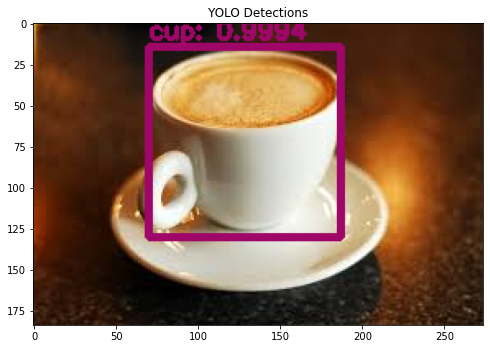

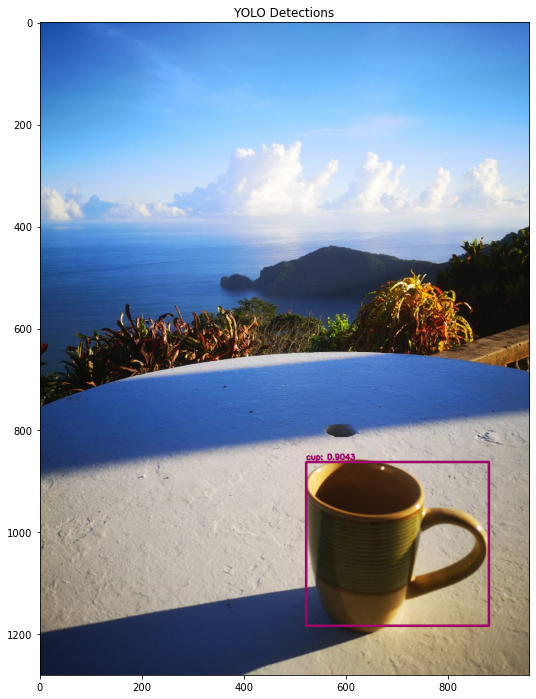

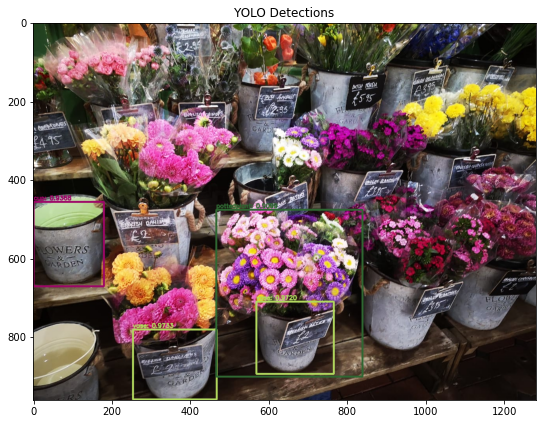

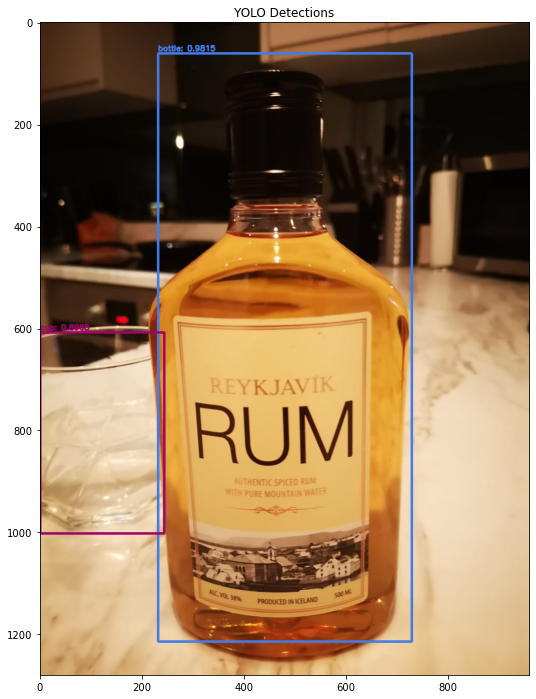

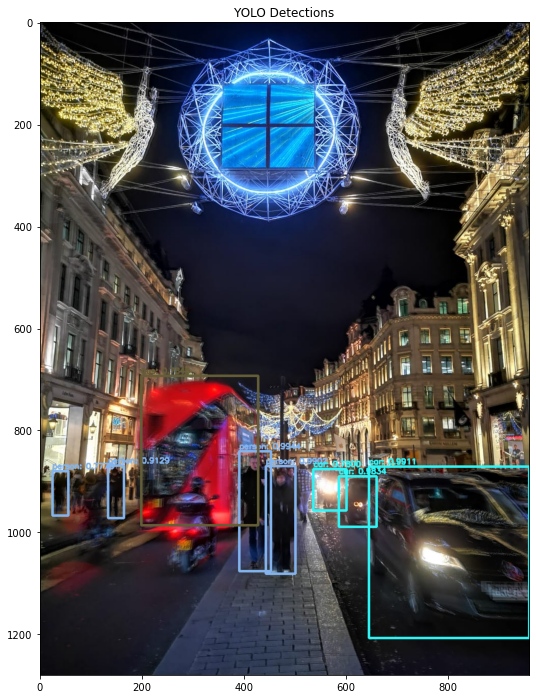

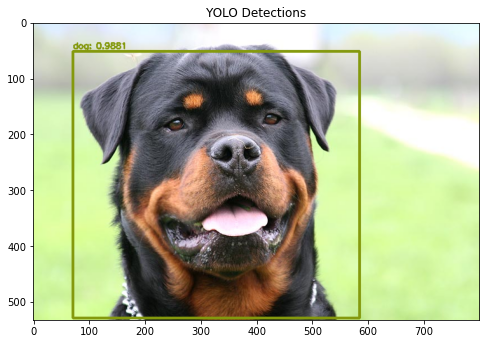

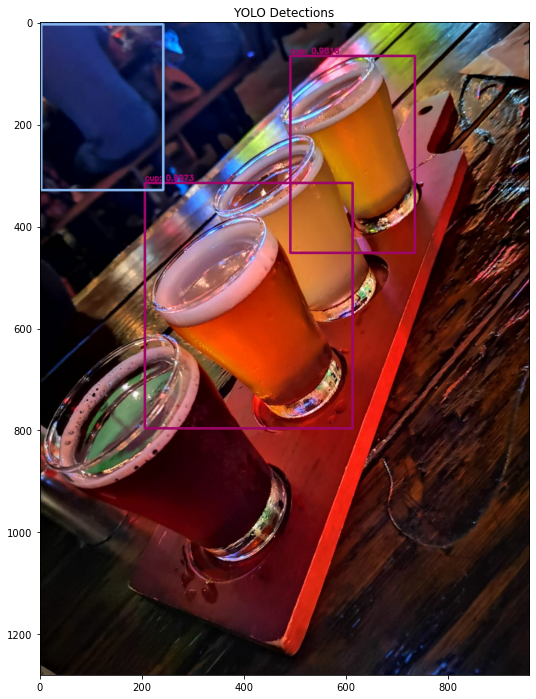

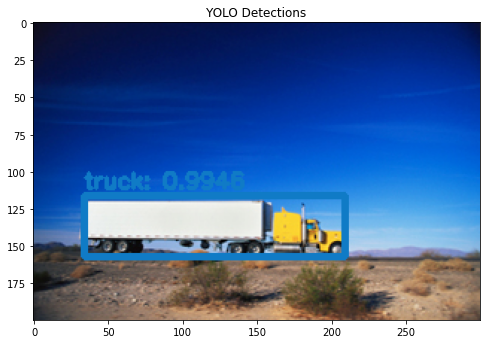

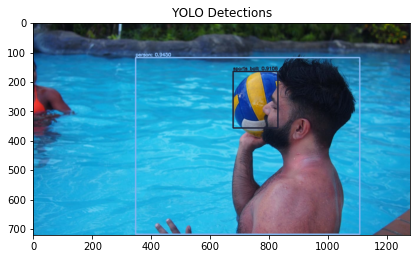

In [12]:
print("Starting Detections...")
# Get images located in ./images folder    
mypath = "../YOLO/YOLO/images"
file_names = [f for f in listdir(mypath) if isfile(join(mypath, f))]

# Loop through images run them through our classifer
for file in file_names:
    # load our input image and grab its spatial dimensions
    image = cv2.imread(mypath+'/'+file)
    (H, W) = image.shape[:2]
 
    # we want only the *output* layer names that we need from YOLO
    ln = net.getLayerNames()
    ln = [ln[i[0] - 1] for i in net.getUnconnectedOutLayers()]

    # Now we contruct our blob from our input images
    blob = cv2.dnn.blobFromImage(image, 1 / 255.0, (416, 416), swapRB=True, crop=False)
    # We set our input to our image blob
    net.setInput(blob)
    # Then we run a forward pass through the network
    layerOutputs = net.forward(ln)

    # we initialize our lists for our detected bounding boxes, confidences, and classes
    boxes = []
    confidences = []
    IDs = []

    # Loop over each of the layer outputs
    for output in layerOutputs:

        # Loop over each detection
        for detection in output:
            # Obtain class ID and probality of detection
            scores = detection[5:]
            classID = np.argmax(scores)
            confidence = scores[classID]

            # We keep only the most probably predictions
            if confidence > 0.75:
                # We scale the bounding box coordinates relative to the image
                # Note: YOLO actually returns the center (x, y) of the bounding
                # box followed by the width and height of the box
                box = detection[0:4] * np.array([W, H, W, H])
                (centerX, centerY, width, height) = box.astype("int")

                # Get the the top and left corner of the bounding box
                # Remember we alredy have the width and height
                x = int(centerX - (width / 2))
                y = int(centerY - (height / 2))

                # Append our list of bounding box coordinates, confidences and class IDs
                boxes.append([x, y, int(width), int(height)])
                confidences.append(float(confidence))
                IDs.append(classID)

    # Now we apply non-maxima suppression to reduce overlapping bounding boxes
    idxs = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.3)

    # We proceed once a detection has been found
    if len(idxs) > 0:
        # iterate over the indexes we are keeping
        for i in idxs.flatten():
            # Get the bounding box coordinates
            (x, y) = (boxes[i][0], boxes[i][1])
            (w, h) = (boxes[i][2], boxes[i][3])

            # Draw our bounding boxes and put our class label on the image
            color = [int(c) for c in COLORS[IDs[i]]]
            cv2.rectangle(image, (x, y), (x + w, y + h), color, 3)
            text = "{}: {:.4f}".format(LABELS[IDs[i]], confidences[i])
            cv2.putText(image, text, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # show the output image
    imshow("YOLO Detections", image, size = 12)

In [5]:
mypath = "../YOLO/YOLO/images"
file_names = [f for f in listdir(mypath) if isfile(join(mypath, f))]

In [6]:
file_names

['coffee.jpg',
 'coffee_view.jpeg',
 'flowers.jpeg',
 'iceland_rum.jpeg',
 'londonxmas2.jpeg',
 'rot.jpg',
 'tommys_beers.jpeg',
 'truck.jpg',
 'Volleyball.jpeg']

In [7]:
for file in file_names:
    # load our input image and grab its spatial dimensions
    image = cv2.imread(mypath+file)
    (H, W) = image.shape[:2]

AttributeError: 'NoneType' object has no attribute 'shape'

In [8]:
mypath+file

'../YOLO/YOLO/imagescoffee.jpg'

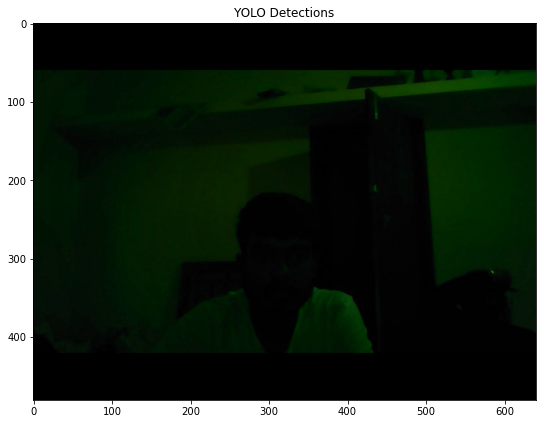

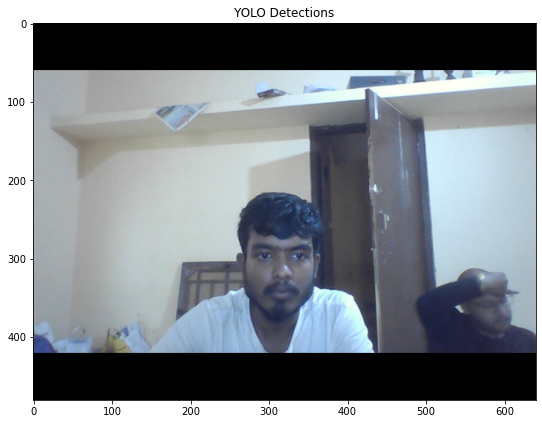

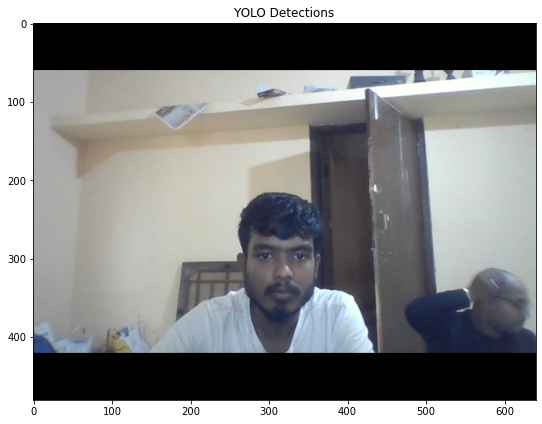

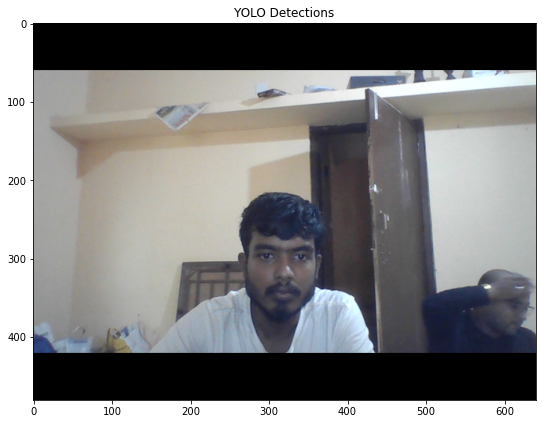

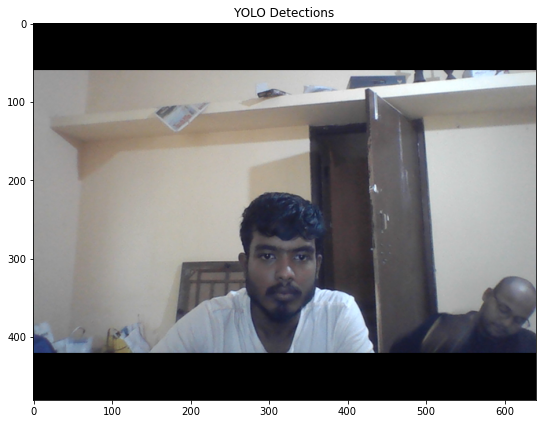

...

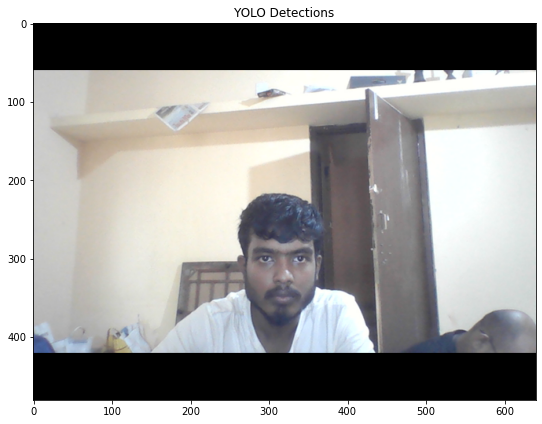

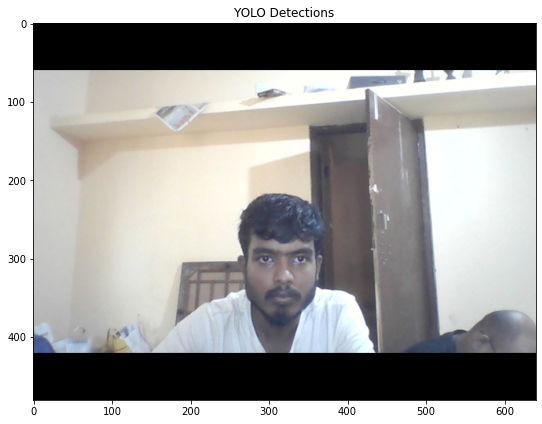

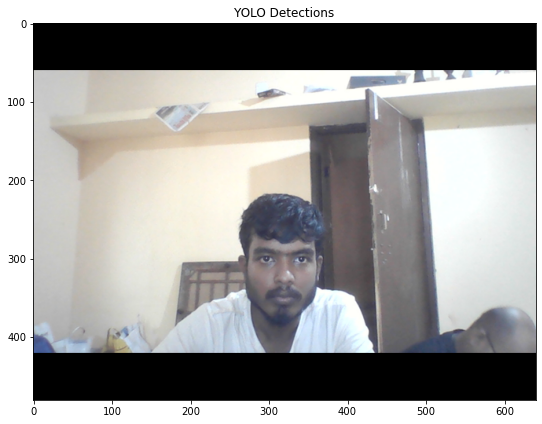

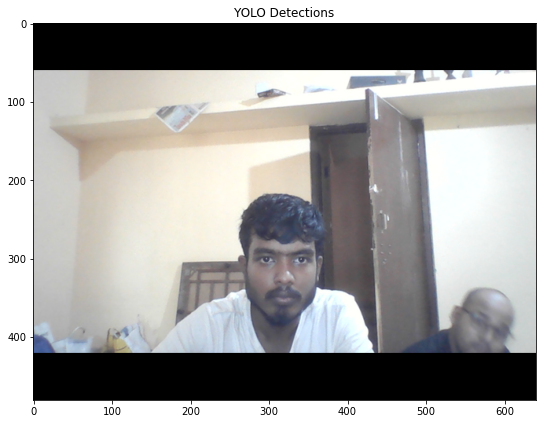

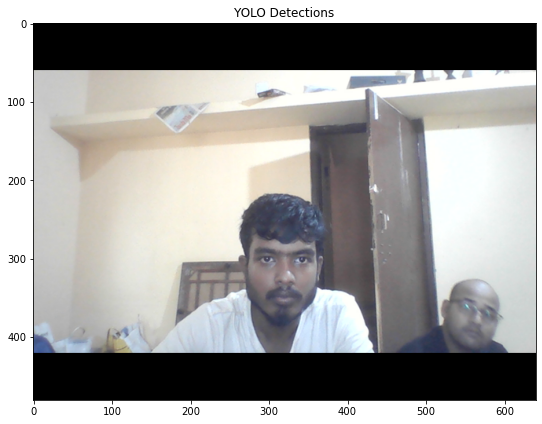

KeyboardInterrupt: 

In [11]:
camera = cv2.VideoCapture(0)
while True:
    # Capturing frame-by-frame from camera
    _, frame = camera.read()

    # Getting spatial dimensions of the frame
    # we do it only once from the very beginning
    # all other frames have the same dimension
    if w is None or h is None:
        # Slicing from tuple only first two elements
        h, w = frame.shape[:2]

    ln = net.getLayerNames()
    ln = [ln[i[0] - 1] for i in net.getUnconnectedOutLayers()]

    # Now we contruct our blob from our input images
    blob = cv2.dnn.blobFromImage(image, 1 / 255.0, (416, 416), swapRB=True, crop=False)
    # We set our input to our image blob
    net.setInput(blob)
    # Then we run a forward pass through the network
    layerOutputs = net.forward(ln)

    # we initialize our lists for our detected bounding boxes, confidences, and classes
    boxes = []
    confidences = []
    IDs = []

    # Loop over each of the layer outputs
    for output in layerOutputs:

        # Loop over each detection
        for detection in output:
            # Obtain class ID and probality of detection
            scores = detection[5:]
            classID = np.argmax(scores)
            confidence = scores[classID]

            # We keep only the most probably predictions
            if confidence > 0.75:
                # We scale the bounding box coordinates relative to the image
                # Note: YOLO actually returns the center (x, y) of the bounding
                # box followed by the width and height of the box
                box = detection[0:4] * np.array([W, H, W, H])
                (centerX, centerY, width, height) = box.astype("int")

                # Get the the top and left corner of the bounding box
                # Remember we alredy have the width and height
                x = int(centerX - (width / 2))
                y = int(centerY - (height / 2))

                # Append our list of bounding box coordinates, confidences and class IDs
                boxes.append([x, y, int(width), int(height)])
                confidences.append(float(confidence))
                IDs.append(classID)

    # Now we apply non-maxima suppression to reduce overlapping bounding boxes
    idxs = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.3)

    # We proceed once a detection has been found
    if len(idxs) > 0:
        # iterate over the indexes we are keeping
        for i in idxs.flatten():
            # Get the bounding box coordinates
            (x, y) = (boxes[i][0], boxes[i][1])
            (w, h) = (boxes[i][2], boxes[i][3])

            # Draw our bounding boxes and put our class label on the image
            color = [int(c) for c in COLORS[IDs[i]]]
            cv2.rectangle(image, (x, y), (x + w, y + h), color, 3)
            text = "{}: {:.4f}".format(LABELS[IDs[i]], confidences[i])
            cv2.putText(image, text, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # show the output image
    imshow("YOLO Detections", frame, size = 12)

    # Breaking the loop if 'q' is pressed
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

    """
    End of:
    Showing processed frames in OpenCV Window
    """

"""
End of:
Reading frames in the loop
"""


# Releasing camera
camera.release()
# Destroying all opened OpenCV windows
cv2.destroyAllWindows()

